# Шишкин Александр, группа 0391

# Практическое задание №1

Цель работы - решение задач компьютерного зрения в системах управления с использованием предобученных моделей сверточных нейронных сетей из библиотеки PyTorch (см. https://pytorch.org/vision/stable/models.html).

Преимущество предобученных моделей - получение быстрого результата без погружения в детали реализации и выполнения трудоемкого процесса настройки на крупных библиотеках изображений.

Их недостатоки - возможны ограничения лицензий использования как на использованный при обучении набор данных, так и на сами коэффициенты из библиотеки и исходный код модели. Ещё одним недостатком является то, что такие весовые коэффицпенты расчитываются на публичных библиотеках изображений и зачастую могут оказаться нерелеванты решаемой задаче.

Последнюю проблему обычно решают с помощью набора приемов, известных в англоязычной литературе как "Transfer learning". Суть его состоит в использовании библиотечных коэффициентов и модели как базы для настройки новой модели.

Ниже будет проиллюстрировано решение задач классификации и донастройки модели с использованием библиотеки PyTorch.

## 1. Инициализация преднастроенных нейросетевых моделей

In [72]:
from torchvision import models

alexNet = {
    # https://papers.nips.cc/paper/2012/hash/c399862d3b9d6b76c8436e924a68c45b-Abstract.html
    'model': models.alexnet(weights=models.AlexNet_Weights.DEFAULT),
    'weights': models.AlexNet_Weights.DEFAULT,
    'preprocess': models.AlexNet_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[1].in_features
}

resNet50 = {
    # https://arxiv.org/abs/1512.03385
    'model': models.resnet50(weights=models.ResNet50_Weights.DEFAULT),
    'weights': models.ResNet50_Weights.DEFAULT,
    'preprocess': models.ResNet50_Weights.DEFAULT.transforms(),
    'output_layer': 'fc',
    'in_features': lambda model: model.fc.in_features
}

denseNet = {
    # https://arxiv.org/abs/1608.06993
    'model': models.densenet201(weights=models.DenseNet201_Weights.DEFAULT),
    'weights': models.DenseNet201_Weights.DEFAULT,
    'preprocess': models.DenseNet201_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

mobileNetV3_small = {
    # https://arxiv.org/abs/1905.02244
    'model': models.mobilenet_v3_small(weights=models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT),
    'weights': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT,
    'preprocess': models.mobilenetv3.MobileNet_V3_Small_Weights.DEFAULT.transforms(),
    'output_layer': 'classifier',
    'in_features': lambda model: model.classifier[0].in_features
}

swinT = {
    # https://arxiv.org/abs/2103.14030
    'model': models.swin_t(weights=models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT),
    'weights': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT,
    'preprocess': models.Swin_T_Weights.IMAGENET1K_V1.DEFAULT.transforms(),
    'output_layer': 'head',
    'in_features': lambda model: model.head.in_features
}



Далее необходимо определиться с вычислительной подсистемой (CPU или GPU).

In [73]:
import torch

gpu = 'has' if torch.cuda.is_available() else 'has no'
print(f'Current environment {gpu} GPU support')
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
!lscpu
print(f'GPU count = {torch.cuda.device_count() if torch.cuda.is_available() else "0"}')

for model in [resNet50, alexNet, denseNet, mobileNetV3_small, swinT]:
    model['model'].to(device)
    model['preprocess'].to(device)
    model['model'].eval()

Current environment has GPU support
Architecture:                x86_64
  CPU op-mode(s):            32-bit, 64-bit
  Address sizes:             46 bits physical, 48 bits virtual
  Byte Order:                Little Endian
CPU(s):                      2
  On-line CPU(s) list:       0,1
Vendor ID:                   GenuineIntel
  Model name:                Intel(R) Xeon(R) CPU @ 2.20GHz
    CPU family:              6
    Model:                   79
    Thread(s) per core:      2
    Core(s) per socket:      1
    Socket(s):               1
    Stepping:                0
    BogoMIPS:                4399.99
    Flags:                   fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pg
                             e mca cmov pat pse36 clflush mmx fxsr sse sse2 ss h
                             t syscall nx pdpe1gb rdtscp lm constant_tsc rep_goo
                             d nopl xtopology nonstop_tsc cpuid tsc_known_freq p
                             ni pclmulqdq ssse3 fma cx16 pcid ss

## Вспомогательные функции

In [105]:
import os
import time
import copy
import math

import typing
from typing import Callable
from functools import partial

import numpy
import pandas
from pandas.core.arrays import boolean
import matplotlib.pyplot as plt
from requests import get

from torch import Tensor, nn
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToPILImage, Compose, Resize, CenterCrop
from torchvision.io import read_image


strip_chars = ' \t'
tmp_file_name = 'tmp_file_name_for_image_download'

to_image = ToPILImage()

detected_classes = []
times_of_detection = []

def classify(dataset: Dataset,
                preprocess: typing.Callable[[Tensor],Tensor],
                num_per_row: int, single_size: float,
                labels: typing.List[str],
                model_labels: typing.List[str] = None,
                model: typing.Callable[[Tensor], Tensor] = None,
                debug: typing.Any = False,
                num_of_classes: int = 1,
                vspace: float = 0.3
             ) -> None:
    if detected_classes:
      detected_classes.clear()
    if times_of_detection:
      times_of_detection.clear()
    num = len(dataset)
    fig, axs = plt.subplots(math.ceil(num/num_per_row), num_per_row, figsize=(
        single_size*num_per_row, (single_size + vspace)*(math.ceil(num/num_per_row))),
        sharex=True, sharey=True)
    for i in range(0, len(dataset)):
        try:
            image, label = dataset[i]
            pred = None

            if model is not None and model_labels is not None:
                start_time = time.perf_counter_ns()
                score = model(image.unsqueeze(0)).detach().squeeze(0).softmax(0)
                pred_index = numpy.flip(score.detach().cpu().argsort().numpy())[0]
                end_time = time.perf_counter_ns()
                class_and_accuracy = f'{model_labels[pred_index]}[{score[pred_index].item()*100:.0f}%]'
                detected_classes.append(class_and_accuracy)
                time_of_detection = f'{(end_time - start_time) / 1_000_000:.0f}'
                times_of_detection.append(time_of_detection)
                pred = f'Detector: {time_of_detection}ms\n{class_and_accuracy}'

            loc_fig = axs[i//num_per_row, i % num_per_row]
            loc_fig.imshow(to_image(preprocess(image)))
            title =f'\nActual: {labels[label]}[{label}]\n{pred}'
            loc_fig.title.set_text(title)
        except Exception as ex:
            if debug:
                raise ex
            print(f'Image {i} is failed to load: {str(ex)}')

    fig.subplots_adjust(wspace=0.3)
    plt.show()


def denormalize(dataset: Dataset, trans: typing.Any) -> Callable[[Tensor], Tensor]:
    image, label = dataset[0]
    std = torch.as_tensor(trans.std, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    mean = torch.as_tensor(trans.mean, dtype=image.dtype, device=image.device).view(-1, 1, 1)
    return lambda img: img*std + mean


class UrlDataset(Dataset):

    def __init__(self, file: str, to_device, transform = None) -> None:
        self.file = file
        self.transform = transform
        self.dataset = pandas.read_csv(file, sep=';')
        self.classes = self.dataset['label'].unique()
        self.classes.sort()
        self.class_to_index = {self.classes[i] : i for i in range(len(self.classes))}
        self.device = to_device

    def __len__(self) -> int:
        return len(self.dataset)

    def __getitem__(self, index: int) -> typing.Tuple[torch.Tensor, str]:
        url = self.dataset.iloc[index]['url'].strip(strip_chars)
        with open(tmp_file_name, 'wb') as file:
            file.write(get(url).content)
        image = read_image(tmp_file_name).to(self.device)
        label = self.class_to_index[self.dataset.iloc[index]['label']]
        if self.transform:
            return self.transform(image), label
        return image, label


def train_model(model, dataloader: DataLoader, device: torch.device,
                critery, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_loss = 0.0
    best_epoch = -1

    process = {'train': {'loss': [], 'accuracy': []}, 'validate': {'loss': [], 'accuracy': []}}

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)
        epoch_loss = 0.0
        epoch_acc = 0.0
        for item in dataloader:
            if item['train'] == True:
                model.train()
            else:
                model.eval()
            running_loss = 0.0
            running_corrects = 0
            dataset_size = 0
            for inputs, labels in item['loader']:
                dataset_size = dataset_size + 1
                inputs = inputs.to(device)
                labels = labels.to(device)
                optimizer.zero_grad()
                with torch.set_grad_enabled(item['train'] == True):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = critery(outputs, labels)
                    if item['train'] == True:
                        loss.backward()
                        optimizer.step()
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if item['train'] == True:
                scheduler.step()

            epoch_loss = running_loss / dataset_size
            epoch_acc = running_corrects.detach().cpu().double() / dataset_size

            if item['train'] == True:
                ptype = 'train'
            else:
                ptype = 'validate'

            process[ptype]['loss'].append(epoch_loss)
            process[ptype]['accuracy'].append(epoch_acc)

            print(f'[{epoch}][train={item["train"]}] Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if item['train'] == True and 1/epoch_loss > best_loss:
                best_loss = 1/epoch_loss
                best_model_wts = copy.deepcopy(model.state_dict())
                best_epoch = epoch

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val loss: {1/best_loss:4f} at epoch {best_epoch}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, process


## Пример описания данных для классификации

В практическом задании набор данных (датасет) формализуется в виде CSV-файла, содержащего URL изображения из интернета и вручную назначенных меток объектов (названий классов), к которому каждое изображение относится.

In [75]:
%%writefile simple.csv
label;url
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_1?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_2?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_3?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_4?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_5?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_6?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_7?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_8?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_9?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_10?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_11?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_12?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_13?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_14?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_15?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_16?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_17?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_18?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_19?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_20?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_21?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_22?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_23?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_24?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_25?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_26?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_27?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_28?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_29?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_30?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_31?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_32?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_33?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_34?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_35?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_36?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_37?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_38?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_39?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_40?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_41?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_42?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_43?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_44?raw=true
узел учёта;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_45?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_46?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_47?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_48?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_49?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_50?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_51?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_52?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_53?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_54?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_55?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_56?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_57?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_58?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_59?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_60?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_61?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_62?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_63?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_64?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_65?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_66?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_67?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_68?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_69?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_70?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_71?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_72?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_73?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_74?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_75?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_76?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_77?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_78?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_79?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_80?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_81?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_82?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_83?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_84?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_85?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_86?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_87?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_88?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_89?raw=true
фильтр-сепаратор;https://github.com/sanka-eu/neural_network_course/blob/main/20_variant_practice_1_imgs/dataset_20_variant.csv_image_90?raw=true

Overwriting simple.csv


## Классификация изображений с библиотечными коэффициентами

### AlexNet

In [100]:
model = alexNet
transform = model['preprocess']
simple = UrlDataset("simple.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: AlexNet
Number of parameters: 61100840


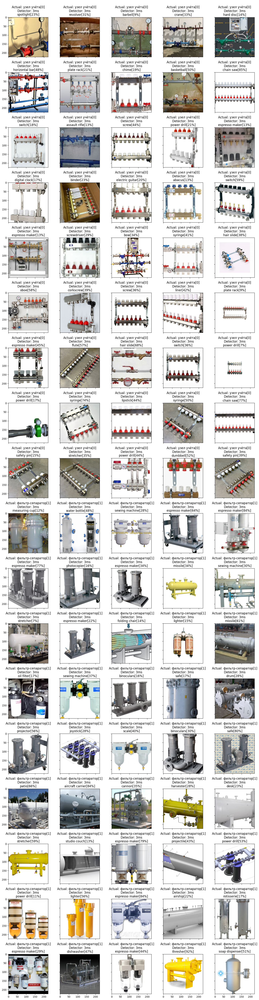

In [110]:
num_per_row = 5
single_size = 3.5
vspace = 0.4

classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
            labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
            debug=True)

#### Результаты выполнения с GPU

In [111]:
for class_and_accuracy_index in range(len(detected_classes)):
  print(class_and_accuracy_index + 1, detected_classes[class_and_accuracy_index])

1 spotlight[23%]
2 revolver[31%]
3 barbell[9%]
4 crane[33%]
5 hard disc[14%]
6 horizontal bar[48%]
7 plate rack[21%]
8 chime[19%]
9 basketball[50%]
10 chain saw[85%]
11 switch[18%]
12 assault rifle[13%]
13 screw[44%]
14 power drill[21%]
15 espresso maker[13%]
16 digital clock[17%]
17 binder[23%]
18 electric guitar[20%]
19 abacus[13%]
20 switch[59%]
21 espresso maker[13%]
22 screwdriver[29%]
23 bow[34%]
24 syringe[41%]
25 hair slide[38%]
26 oboe[58%]
27 corkscrew[39%]
28 screw[36%]
29 liner[42%]
30 plate rack[9%]
31 espresso maker[45%]
32 flute[57%]
33 hair slide[68%]
34 switch[36%]
35 power drill[7%]
36 power drill[17%]
37 syringe[74%]
38 lipstick[44%]
39 syringe[50%]
40 chain saw[77%]
41 safety pin[15%]
42 stretcher[35%]
43 power drill[44%]
44 dumbbell[52%]
45 safety pin[39%]
46 measuring cup[12%]
47 water bottle[48%]
48 sewing machine[28%]
49 espresso maker[64%]
50 espresso maker[84%]
51 espresso maker[77%]
52 photocopier[16%]
53 espresso maker[34%]
54 missile[34%]
55 sewing machine[

In [114]:
total  = sum(float(n) if n else 0 for n in times_of_detection)
print(f'Среднее время классификации: {total / len(times_of_detection):.0f}ms')

Среднее время классификации: 3ms


Точность модели: 1/90 ≈ 0.01 (принял распознавание масляного фильтра как правильное, точность минимальная)

### ResNet50

In [115]:
model = resNet50
transform = model['preprocess']
simple = UrlDataset("simple.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: ResNet
Number of parameters: 25557032


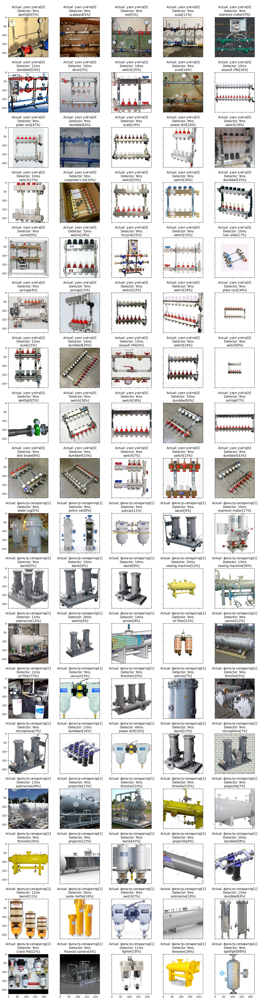

In [116]:
num_per_row = 5
single_size = 3.5
vspace = 0.4

classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
            labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
            debug=True)

#### Результаты выполнения с GPU

In [117]:
for class_and_accuracy_index in range(len(detected_classes)):
  print(class_and_accuracy_index + 1, detected_classes[class_and_accuracy_index])

1 spotlight[5%]
2 scabbard[5%]
3 reel[5%]
4 scale[11%]
5 espresso maker[3%]
6 dumbbell[20%]
7 drum[5%]
8 switch[35%]
9 scale[14%]
10 assault rifle[16%]
11 plate rack[47%]
12 dumbbell[4%]
13 scale[19%]
14 power drill[16%]
15 switch[18%]
16 switch[27%]
17 carpenter's kit[10%]
18 switch[53%]
19 switch[30%]
20 dumbbell[35%]
21 cornet[9%]
22 switch[18%]
23 tricycle[25%]
24 switch[33%]
25 hair slide[17%]
26 syringe[4%]
27 syringe[15%]
28 switch[23%]
29 switch[16%]
30 plate rack[34%]
31 scale[25%]
32 dumbbell[26%]
33 assault rifle[4%]
34 switch[24%]
35 switch[9%]
36 spotlight[5%]
37 switch[38%]
38 switch[18%]
39 dumbbell[6%]
40 syringe[7%]
41 disk brake[6%]
42 dumbbell[10%]
43 switch[7%]
44 switch[15%]
45 dumbbell[43%]
46 water jug[5%]
47 police van[8%]
48 ashcan[11%]
49 barrel[9%]
50 espresso maker[17%]
51 barrel[5%]
52 barrel[4%]
53 barrel[9%]
54 sewing machine[22%]
55 sewing machine[28%]
56 submarine[14%]
57 switch[4%]
58 printer[8%]
59 oil filter[23%]
60 cannon[12%]
61 oil filter[73%]
62 

In [118]:
total  = sum(float(n) if n else 0 for n in times_of_detection)
print(f'Среднее время классификации: {total / len(times_of_detection):.0f}ms')

Среднее время классификации: 10ms


Точность модели: 2/90 ≈ 0.02 (принял распознавание масляного фильтра как правильное, точность минимальная)

### DenseNet

In [119]:
model = denseNet
transform = model['preprocess']
simple = UrlDataset("simple.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: DenseNet
Number of parameters: 20013928


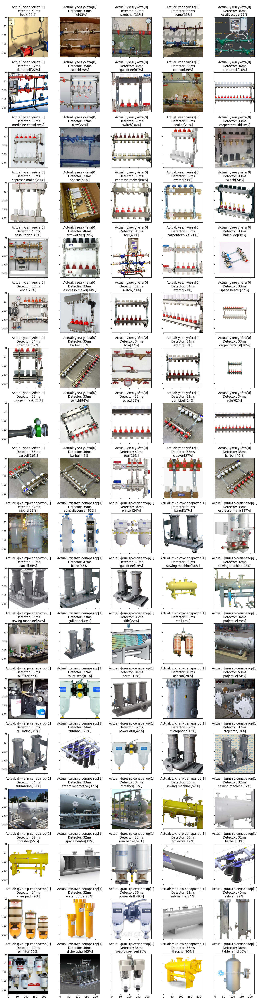

In [120]:
num_per_row = 5
single_size = 3.5
vspace = 0.4

classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
            labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
            debug=True)

#### Результаты выполнения с GPU

In [121]:
for class_and_accuracy_index in range(len(detected_classes)):
  print(class_and_accuracy_index + 1, detected_classes[class_and_accuracy_index])

1 hook[22%]
2 rifle[93%]
3 stretcher[33%]
4 crane[35%]
5 oscilloscope[23%]
6 dumbbell[22%]
7 switch[29%]
8 guillotine[67%]
9 cannon[39%]
10 plate rack[16%]
11 medicine chest[36%]
12 plow[22%]
13 switch[36%]
14 beaker[21%]
15 carpenter's kit[26%]
16 espresso maker[20%]
17 abacus[58%]
18 espresso maker[60%]
19 switch[51%]
20 switch[74%]
21 assault rifle[43%]
22 screwdriver[29%]
23 reel[43%]
24 carpenter's kit[21%]
25 hair slide[88%]
26 oboe[29%]
27 espresso maker[44%]
28 switch[28%]
29 switch[24%]
30 space heater[27%]
31 stretcher[67%]
32 barbell[50%]
33 bow[32%]
34 switch[35%]
35 carpenter's kit[10%]
36 oxygen mask[21%]
37 switch[94%]
38 screw[58%]
39 dumbbell[24%]
40 rule[62%]
41 barbell[36%]
42 barbell[48%]
43 reel[16%]
44 cleaver[27%]
45 barbell[40%]
46 nipple[33%]
47 soap dispenser[83%]
48 printer[24%]
49 barrel[37%]
50 espresso maker[87%]
51 barrel[35%]
52 barrel[43%]
53 guillotine[19%]
54 sewing machine[36%]
55 sewing machine[25%]
56 sewing machine[24%]
57 guillotine[45%]
58 rifle

In [122]:
total  = sum(float(n) if n else 0 for n in times_of_detection)
print(f'Среднее время классификации: {total / len(times_of_detection):.0f}ms')

Среднее время классификации: 35ms


Точность модели: 2/90 ≈ 0.02 (принял распознавание масляного фильтра как правильное, точность минимальная)

### MobileNetV3_small

In [123]:
model = mobileNetV3_small
transform = model['preprocess']
simple = UrlDataset("simple.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: MobileNetV3
Number of parameters: 2542856


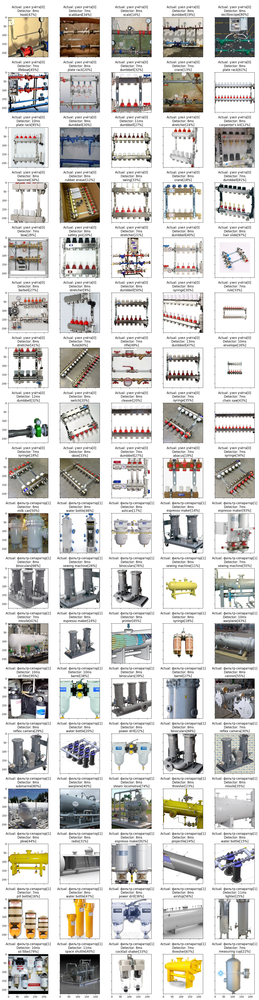

In [124]:
num_per_row = 5
single_size = 3.5
vspace = 0.4

classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
            labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
            debug=True)

#### Результаты выполнения с GPU

In [125]:
for class_and_accuracy_index in range(len(detected_classes)):
  print(class_and_accuracy_index + 1, detected_classes[class_and_accuracy_index])

1 hook[47%]
2 scabbard[34%]
3 scale[14%]
4 dumbbell[19%]
5 oscilloscope[80%]
6 lifeboat[45%]
7 plate rack[20%]
8 dumbbell[32%]
9 crane[13%]
10 plate rack[61%]
11 plate rack[85%]
12 dumbbell[30%]
13 dumbbell[27%]
14 stretcher[24%]
15 carpenter's kit[12%]
16 bassinet[34%]
17 rubber eraser[12%]
18 swing[33%]
19 crane[18%]
20 dumbbell[81%]
21 bow[28%]
22 safety pin[20%]
23 stretcher[21%]
24 dumbbell[40%]
25 hair slide[97%]
26 barbell[27%]
27 stretcher[9%]
28 dumbbell[50%]
29 syringe[30%]
30 rule[33%]
31 stretcher[41%]
32 flute[60%]
33 rifle[49%]
34 dumbbell[47%]
35 envelope[16%]
36 dumbbell[32%]
37 switch[20%]
38 cleaver[20%]
39 syringe[35%]
40 chain saw[43%]
41 syringe[18%]
42 oboe[33%]
43 dumbbell[27%]
44 abacus[19%]
45 syringe[34%]
46 milk can[50%]
47 water bottle[46%]
48 ashcan[17%]
49 espresso maker[14%]
50 espresso maker[93%]
51 binoculars[66%]
52 sewing machine[26%]
53 binoculars[76%]
54 sewing machine[11%]
55 sewing machine[55%]
56 missile[41%]
57 espresso maker[24%]
58 printer[45%

In [126]:
total  = sum(float(n) if n else 0 for n in times_of_detection)
print(f'Среднее время классификации: {total / len(times_of_detection):.0f}ms')

Среднее время классификации: 8ms


Точность модели: 2/90 ≈ 0.02 (принял распознавание масляного фильтра как правильное, точность минимальная)

### SwinT

In [127]:
model = swinT
transform = model['preprocess']
simple = UrlDataset("simple.csv", device, transform)

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

----------------------------------------------------------------------
Model: SwinTransformer
Number of parameters: 28288354


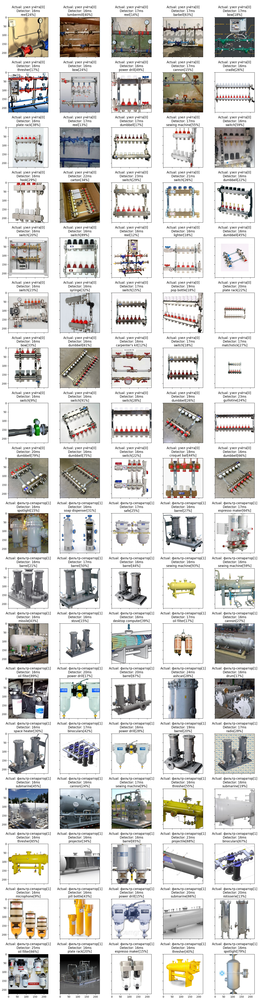

In [128]:
num_per_row = 5
single_size = 3.5
vspace = 0.4

classify(simple, denormalize(simple, transform), num_per_row=num_per_row, single_size=single_size, vspace = vspace,
            labels = simple.classes, model=model['model'], model_labels=model['weights'].meta["categories"],
            debug=True)

#### Результаты выполнения с GPU

In [129]:
for class_and_accuracy_index in range(len(detected_classes)):
  print(class_and_accuracy_index + 1, detected_classes[class_and_accuracy_index])

1 reel[24%]
2 lumbermill[40%]
3 reel[14%]
4 barbell[63%]
5 bow[18%]
6 thresher[17%]
7 bow[24%]
8 power drill[49%]
9 cannon[15%]
10 cradle[26%]
11 plate rack[38%]
12 reel[13%]
13 dumbbell[17%]
14 sewing machine[55%]
15 switch[59%]
16 hook[29%]
17 carton[34%]
18 switch[29%]
19 switch[26%]
20 dumbbell[22%]
21 switch[20%]
22 switch[89%]
23 reel[12%]
24 lighter[18%]
25 dumbbell[45%]
26 switch[23%]
27 syringe[32%]
28 switch[15%]
29 pop bottle[18%]
30 plate rack[22%]
31 bow[33%]
32 dumbbell[61%]
33 carpenter's kit[12%]
34 switch[18%]
35 matchstick[27%]
36 switch[9%]
37 switch[91%]
38 switch[28%]
39 dumbbell[26%]
40 guillotine[24%]
41 dumbbell[79%]
42 dumbbell[75%]
43 switch[22%]
44 croquet ball[44%]
45 dumbbell[66%]
46 spotlight[15%]
47 soap dispenser[31%]
48 safe[25%]
49 barrel[27%]
50 espresso maker[64%]
51 barrel[21%]
52 barrel[50%]
53 barrel[44%]
54 sewing machine[93%]
55 sewing machine[59%]
56 missile[43%]
57 stove[15%]
58 desktop computer[39%]
59 oil filter[17%]
60 cannon[27%]
61 oil fi

In [130]:
total  = sum(float(n) if n else 0 for n in times_of_detection)
print(f'Среднее время классификации: {total / len(times_of_detection):.0f}ms')

Среднее время классификации: 17ms


Точность модели: 2/90 ≈ 0.02 (принял распознавание масляного фильтра как правильное, точность минимальная)

# Подготовка датасета для донастройки модели

Предположим, что необходимло разработать "робота", собирающего мусор на улице двух типов - смятые бутылки из под воды и алюминевые банки для последующей переработки. Одной из подсистем такого робата будет система компьютерного зрения, которая должна будет определять, какой объект находится перед камерой (в нашем "учебном" случае это может быть только пластиковая буфтылка из под воды или красная алюминевая банка. В реальной ситуации число типов объектов наверняка будет исчисляться сотнями и тысячами).

Для донастройки библиотечных моделей первым дело необходимо сформировать два датасета, один для настройки выходных слоев нейронной сети, другой - для валидации новой модели (проверки её качества). В обоих случаях датасет помимо самих изображений должен содержать метки классов, к которым эти изображения относятся.

In [87]:
%%writefile train.csv
label;url
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_1?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_2?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_3?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_4?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_5?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_6?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_7?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_8?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_9?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_10?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_11?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_12?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_13?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_14?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_15?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_16?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_17?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_18?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_19?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/train.csv_image_20?raw=true

Overwriting train.csv


In [88]:
%%writefile test.csv
label;url
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_1?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_2?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_3?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_4?raw=true
bottle;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_5?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_6?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_7?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_8?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_9?raw=true
cola can;https://github.com/ant-nik/neural_network_course/blob/main/practice_1_imgs/test.csv_image_10?raw=true

Overwriting test.csv


Датасет в библиогтеки PyTorch представлен базовым классом Dataset, описывающий способ загрузки и трансформации набора данных по запросу.
Начнем с описания процесса "подгрузки" изображений по url и лэйблу из CSV-файла с описанием датасета.

После подготовки класса со сценарием загрузки изображений, его можно проверить путем визуализации с помощью библиотеки Matplotlib.

In [89]:
transform = model['preprocess']
train = UrlDataset("train.csv", device, transform)
test = UrlDataset('test.csv', device, transform)

num_per_row = 5
single_size = 3.5
vspace = 0.3

print('-'*70)
print(f'Model: { model["model"].__class__.__name__}')
print(f'Number of parameters: {sum(item.numel() for item in model["model"].parameters())}')

print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=model['model'], model_labels=model['weights'].meta["categories"])
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=model['model'], model_labels=model['weights'].meta["categories"])

----------------------------------------------------------------------
Model: SwinTransformer
Number of parameters: 28288354
------------------------------ Train dataset ------------------------------


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7cde0c741940> (for post_execute):


KeyboardInterrupt: 

Как видно из результата, зачастую стандартный набор классов известных датасетов не покрывает нужные в специфических задачах. Тем не менее есть эффективный способ донастройки модели, который на практике позволяет с одной стороны воспользоваться результатом оптимизации предобученных моделей, с другой - адаптировать их под специфические задачи.

# Предобученная нейронная сеть как генератор признаков




Наиболее простой способ адаптации предобученных моделей к специфической задаче это переобучение выходного классификатора, который вычисляет принадлежность изображения к тому или иному классу. Это возможно благодаря особенности глубоких нейронных сетей, состоящей в том, что по мере преобразования между слоями происходит постепенный переход от конкретного изображения как набора пикселей к более обощённому представлению (пространство признаков), инвариантных к второстепенной информации (фон, повороты, растяжения, освещенность и т.д.). Таким образом, выходной слой лишь использует обобщённое пространство признаков для разделения на области, относящщиеся к разным классам объектов. И если цель состоит в создании иного разбиения, то достаточно заменить выходной слой на новый классификатор, настроив его на распознавание нужных классов объктов.

Популярным способом разбиения пространства признаков в случае существенно отличаюзихся классов является использование линейной гиперповерхности (линейный классификатор). Его преимуществом является простота и как следствие эффективность на небольших выборках. Основной недостаток - невозможность реализации сложных разбиений между близкими классами объектов. Для визуальной проверки возможности применения линейного классификатора в конкретной задаче можно использовать метод редукции многомерного пространства признаков, полученных на выходе предпоследнего слоя предобученной модели.

В моделях библиотеки PyTorch для этого с учетом фиксированной последовательности слоев (специфика библиотеки) необходимо отключить слой классификации, заменив его на единичное преобразование. В таком виде модель нейросети будет играть роль генератора признаков.




В первую очередь рассмотрим структуру модели и найдем в ней выходной классификатор

In [ ]:
print(model)

Выходной слой это classifier (зачастую это даже не один слой, а группа слоев, наделяющих классификатор нужными свойствами).
Уберем его, чтобы получить на выходе набор признаков. Для этого заменим выходной классификатор на единичное преобразование.

In [ ]:
image, label = simple[0]
feature_extractor = copy.deepcopy(model['model'])
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов исходной модели: {result.shape}')
setattr(feature_extractor, model['output_layer'], nn.Identity())
result = feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()
print(f'Размерность выходов модели после замены выходного классификатора на единичное преобразование: {result.shape}')

Попробуем визуализировать ккаим-либо образом пространство признаков, обозначая объекты целевых классов разными цветами. Общая гипотеза состоит в том, что  изображения разных классов должны лежать в разных областях пространства признаков (т.е. они выглядят как сосредоточенные "облака" точек, которые в свою очередь расположены на значительном удвлении друг от друга). В этом случае с помощью линейной гиперплоскости можно спроецировать точки в N-мерном пространстве признаков на эту плоскость и получить одно-, двух- или трехмерные проекции этих облаков, которые уже можно визуализировать на графике. Таким образом, для проверки гипотезы достаточно убедиться, что проекции "облаков" разных классов будут визуально изолированы. В этом случае перенастройка линейного классификатора на выходе нейронной сети приведет к решению задачи классификации на индивидуальной выборке объектов.

Чтобы получить двухмерную проекцию точек пространства признаков воспользуемся методом редукции размерности на основе метода линейного PCA (Principial Component Analysis). Суть его состоит в отыскании такой линейной гиперплоскости в N-мерном пространстве, расстояние до которой всех точек будет минимальным (т.е. она максимально аппроксимирует данные). Координаты спроецированных точек в пространстве этой гиперповерхности как раз и являются искомым двухмерным представлением "облаков", характеризующих разные классы объектов выборки.

Итак, первым делом преобразуем имеющиеся списки изображений в массивы признаков и лэйблов классов.

In [ ]:
output = []
for image, label in torch.utils.data.ConcatDataset([train, test]):
    result = {'label': label, 'feature': feature_extractor(image.unsqueeze(0)).cpu().detach().squeeze(0).numpy()}
    output.append(result)
features = numpy.concatenate([numpy.expand_dims(record['feature'], 0) for record in output])
labels = [record['label'] for i, record in enumerate(output)]

Далее применим PCA-метод, который на основе N-мерных массивов признаков вычислит координаты точек на гиперплоскости (U), список собственных чисел (S) и собственных векторов (V) для преобразования координат между основным и редуцированным пространством.

In [ ]:
totalU, totalS, totalV = torch.pca_lowrank(torch.from_numpy(features), q=2)

Для визуализации остается совершить трансформации осей массивов, чтобы получить ряды для координат абсцис и ординат графика, а также разделить массивы точек разных классов, чтобы каждому задать свой цвет.

In [ ]:
series = {}
for key in ['bottle', 'cola can']:
    points = numpy.concatenate([numpy.expand_dims(totalU[i,:].cpu().detach().numpy(), 0)
        for i, label in enumerate(labels) if train.classes[label] == key])
    series[key] = numpy.moveaxis(points, 1, 0)

plt.figure()
plt.plot(series['bottle'][0], series['bottle'][1], 'ro', series['cola can'][0], series['cola can'][1], 'bo')
plt.legend(['bottle', 'cola can'])
plt.show()

На графике выше видно, что даже на двухмерной проекции точки разных классов лежат в разных областях и могут быть легко разделены прямой. Это означает, что применение линейного классификатора в данном случае выглядит оправданым.

## Донастройка модели под специфическую задачу классификации

Донастройка происходит за счет переобучения выходных слоев глубинной нейронной сети, отвечающих за различие частных деталей разных классов (https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html).

Мы будем использовать простейший классификатор - линейный, который играет роль гиперплоскости в N-мерном пространстве, разделющей пространство признаков на 2 части. Преимуществом такого классификатора является его простота, высокая скорость обучения, а также нужный результат даже при небольшом наборе данных (здесь действует эмпирическое правило: чем проще модель, тем меньше данных нужно для её обучения). Основной недостаток линейного классификатора - недостаточная сложность для случаев, когда классы визуально близки, отличаясь только нюансами. В таких ситуациях гиперплоскость является слишком простой моделью и необходимо использовать нелинейную гиперповерхность (нелинейный классификатор).

Так как мы не планируем менять коэффициенты предобученных слоев, первым делом необходимо отключить их перенастройку.

In [ ]:
tunned_model = copy.deepcopy(model['model'])
for param in tunned_model.parameters():
    param.requires_grad = False

Затем добавим новый слой-классификатор на выходе

In [ ]:
print(tunned_model)

In [ ]:
print(getattr(tunned_model, model['output_layer']))

In [ ]:
in_features = model['in_features'](tunned_model)
print(in_features)

Теперь добавим линейный классификатор с нужным числом входов и двумя выходами. Выход классификатора пропустим через Softmax слой, чтобы получить на вызоде нормированный сигнал из диапазона [0;1].

In [ ]:
setattr(tunned_model, model['output_layer'], torch.nn.Sequential(torch.nn.Linear(in_features, 2), torch.nn.Softmax(dim=1)))

In [ ]:
print(tunned_model)

In [ ]:
print(f"num of adjustable parameters = {sum(i.numel() for i in getattr(tunned_model, model['output_layer']).parameters())}")

Для запуска процесса обучения необходим вспомогательный класс-обертка Dataloader, который позволяет объединять и разбивать наборы данных, заданные с помощью Dataset на фрагменты. Это необходимо, например, для параллелизации процесса настройки в ансамблях моделей, когда выборка разбивается на подвыборки и настройка происходит в  независимых процессах.

In [ ]:
dataloader = [
    {
        'train': True,
        'loader': DataLoader(train, batch_size=1, shuffle=True, num_workers=0)
    },
    {
        'train': False,
        'loader': DataLoader(test, batch_size=1, shuffle=True, num_workers=0)
    }
]

Создадим критерий, оптимизатор и динамически изменяемый коэффициент усиления процесса обучения.

In [ ]:
tunned_model.to(device)
critery = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.SGD(getattr(tunned_model, model['output_layer']).parameters(), lr=0.001, momentum=0.9)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.5)

In [ ]:
print(tunned_model)

Наконец, проведем перенастройку

In [ ]:
model_conv, process = train_model(model=tunned_model, dataloader=dataloader, device=device,
                         critery=critery, optimizer=optimizer, scheduler=lr_scheduler,
                         num_epochs=9)

In [ ]:
fig, axs = plt.subplots(2,2, figsize=(16,10), sharex=True)
axs[0,0].plot(process['train']['loss'])
axs[0,0].title.set_text('Эволюции ошибки на выборке для обучения')
axs[0,1].plot(process['train']['accuracy'])
axs[0,1].title.set_text('Эволюции ошибки на выборке для обучения')
axs[1,0].plot(process['validate']['loss'])
axs[1,0].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,1].plot(process['validate']['accuracy'])
axs[1,1].title.set_text('Эволюции ошибки на выборке для проверки')
axs[1,0].set_xlabel('Итерация обучения')
axs[1,1].set_xlabel('Итерация обучения')
axs[0,0].set_ylabel('Значение ошибки')
axs[1,0].set_ylabel('Значение ошибки')

Выведем результат после обучения

In [ ]:
print('-'*30  + ' Train dataset ' + '-'*30)
classify(train, denormalize(train, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = train.classes, model=tunned_model, model_labels=train.classes, debug=True  )
print('-'*30  + ' Test dataset ' + '-'*30)
classify(test, denormalize(test, transform), num_per_row=num_per_row, single_size=single_size, vspace=vspace,
            labels = test.classes, model=tunned_model, model_labels=test.classes)

## Задание для самостоятельного исследования
1. Подготовить набор изображений (датасет) из двух классов в соотвествии с индивидуальным заданием путем поиска в интернете (например, с использованием https://images.yandex.ru). Число изображений каждого класса должно быть равным. Размер датасета - не менее 50 изображений.

2. Для 5 предобученных моделей (AlexNet, DenseNet, MobileNet, ResNet50, SwinT) провести сравнение процесса классификации на собранном датасете. Для этого построить графики средней скорости классификации изображений для разных моделей (AlexNet, DenseNet, MobileNet, ResNet50, SwinT), сред исполнения (CPU, GPU, TPU) и точности как отношения числа правильно распознанных к общему числу изображений в датасете. В отчете привести примеры успешных/неуспешных результатов (по 1 примеру для каждого класса успешной и неуспешной классификации каждой модели = всего 2х2х5 = 20 примеров с указанием истинного/расчетного класса и степени уверенности в %).

3. Провести донастройку слоя классификации для модели SwinT на собранном датасете, а затем выполнить классификацию. Для этого разбить весь датасет на часть для настройки (80% датасета) и часть для валидации (20% датасета). Привести выход слоёв feature-extractor с редукцией до 2х мерного пространства. Вычислить метрику точности как отношение числа успешно классифицированных к общему числу изображений в выборке. Сравнить результаты с п.2.